Cost >= 1700 = not exist

In [201]:
import matplotlib.pyplot as plt
%matplotlib inline
from IPython.display import Audio
import librosa
import numpy as np
import pandas as pd

In [202]:
### to form cost matrix
def fill_dtw_cost_matrix(s1, s2):
    l_s_1, l_s_2 = len(s1), len(s2)
    cost_matrix = np.zeros((l_s_1+1, l_s_2+1))
    
    ### set all elements to infinity
    for i in range(l_s_1+1):
        for j in range(l_s_2+1):
            cost_matrix[i, j] = np.inf
    
    ### set the first element to 0
    cost_matrix[0, 0] = 0
    
    ### filling in cost matrix
    for i in range(1, l_s_1+1):
        for j in range(1, l_s_2+1):
            cost = abs(s1[i-1] - s2[j-1])
            
            ### take last min from the window
            prev_min = np.min([cost_matrix[i-1, j], cost_matrix[i, j-1], cost_matrix[i-1, j-1]])
            cost_matrix[i, j] = cost + prev_min
            
    return cost_matrix

In [203]:
### to form cost matrix in a faster way by ignoring some elements
def fill_dtw_cost_matrix_fast(s1, s2):
    l_s_1, l_s_2 = len(s1), len(s2)
    cost_matrix = np.zeros((l_s_1+1, l_s_2+1))
    
    ### set all elements to infinity
    for i in range(l_s_1+1):
        for j in range(l_s_2+1):
            cost_matrix[i, j] = np.inf
            
    ### set the first element to 0
    cost_matrix[0, 0] = 0
    
    ### filling in cost matrix
    for i in range(1, l_s_1+1):
        for j in range(1, l_s_2+1):
            a = i-1
            b = j-1
            
            ### ignore some elements for faster computation 
            if abs(a-i)<=5 and abs(b-i)<=5:
                cost = abs(s1[i-1] - s2[j-1])
                
                #### take last min from the window
                prev_min = np.min([cost_matrix[i-1, j], cost_matrix[i, j-1], cost_matrix[i-1, j-1]])
                cost_matrix[i, j] = cost + prev_min
                
    return cost_matrix

In [204]:
### calculate total cost from cost matrix
def cal_Cost(matrix):
    
    ### set the cost equals the first last element in the cost matrix
    cost = matrix[-1,-1]
    
    ### for calculating the number of element
    number_of_element = 1
    
    ### for listing out the element
    element = [matrix[-1,-1]]
    i,j = matrix.shape[0]-1 , matrix.shape[1]-1
    while i is not 1 and j is not 1:
        
        ### find the minimum element around the current element
        min_element = np.min([matrix[i-1,j], matrix[i,j-1], matrix[i-1, j-1]])
        cost += min_element
        number_of_element+=1
        element.append(min_element)
        
        ### get the current position of the element
        if matrix[i-1,j] < matrix[i,j-1] and matrix[i-1,j] < matrix[i-1, j-1]:
            i,j = i-1, j
        elif matrix[i,j-1] < matrix[i-1,j] and matrix[i,j-1] < matrix[i-1, j-1]:
            i,j = i,j-1
        else:
            i,j = i-1, j-1
            
    return cost, number_of_element,element

In [298]:
### show existence of the target word
def exist(cost,number_of_element):
    return "The word is existed in the video" if cost/number_of_element <=1700 else "The word is not existed in the video"

# Testset 1 - OneToTen (OneTwoThree)

In [206]:
yTest, srTest = librosa.load('Test.flac')
Audio(data=yTest, rate=srTest)

In [207]:
y1, sr1 = librosa.load('OneTwoThree1.flac')

In [208]:
mfcc1 = librosa.feature.mfcc(y1, sr1)
mfccTest = librosa.feature.mfcc(yTest,srTest)

In [209]:
#### try the fast way
window_size = mfcc1.shape[1]

dists = np.zeros(mfccTest.shape[1] - window_size)
cost_matrix = []

for i in range(len(dists)):
    mfcci = mfccTest[:,i:i+window_size]
    cost_matrix.append(fill_dtw_cost_matrix_fast(mfcc1[1],mfcci[1]))

In [295]:
### try the fast way
cost_list =[]
for i in range(len(cost_matrix)):
    cost_list.append(cal_Cost(cost_matrix[i]))
    
a1,b1,c1 = min(cost_list)

print(f"Average: {a1/b1}")
print(exist(a1,b1))

Average: 1566.9920706748962
The word is existed in the video


# Testset 2 - OneToTen (FiveSixSeven)

In [211]:
yTest_2, srTest_2 = librosa.load('One_Ten.flac')
Audio(data=yTest_2, rate=srTest_2)

In [212]:
y1_2, sr1_2 = librosa.load('FiveSixSeven1.flac')

In [213]:
mfcc1_2 = librosa.feature.mfcc(y1_2, sr1_2)

mfccTest_2 = librosa.feature.mfcc(yTest_2,srTest_2)

In [214]:
### try the fast way
window_size_2 = mfcc1_2.shape[1]

dists_2 = np.zeros(mfccTest_2.shape[1] - window_size_2)
cost_matrix_2 = []

for i in range(len(dists_2)):
    mfcci = mfccTest_2[:,i:i+window_size_2]
    cost_matrix_2.append(fill_dtw_cost_matrix_fast(mfcc1_2[1],mfcci[1]))

In [296]:
### try the fast way
cost_list_2 =[]
for i in range(len(cost_matrix_2)):
    cost_list_2.append(cal_Cost(cost_matrix_2[i]))
    
a2,b2,c2 = min(cost_list_2)

print(f"Average: {a2/b2}")
print(exist(a2,b2))

Average: 1362.8192961856062
The word is existed in the video


# Testset 3 - No Word - HowAreYou (FiveSixSeven)

In [216]:
yTest_3, srTest_3 = librosa.load('HowAreYou.flac')
Audio(data=yTest_3, rate=srTest_3)

In [217]:
y1_3, sr1_3 = librosa.load('FiveSixSeven1.flac')

In [218]:
mfcc1_3 = librosa.feature.mfcc(y1_3, sr1_3)

mfccTest_3 = librosa.feature.mfcc(yTest_3,srTest_3)

In [219]:
### try the fast way
window_size_3 = mfcc1_3.shape[1]

dists_3 = np.zeros(mfccTest_3.shape[1] - window_size_3)
cost_matrix_3 = []

for i in range(len(dists_3)):
    mfcci = mfccTest_3[:,i:i+window_size_3]
    cost_matrix_3.append(fill_dtw_cost_matrix_fast(mfcc1_3[1],mfcci[1]))

In [299]:
### try the fast way
cost_list_3 =[]
for i in range(len(cost_matrix_3)):
    cost_list_3.append(cal_Cost(cost_matrix_3[i]))
    
a3,b3,c3 = min(cost_list_3)

print(f"Average: {a3/b3}")
print(exist(a3,b3))

Average: 3223.1926835565005
The word is not existed in the video


# Testset 4 - J&T Memohon Maaf

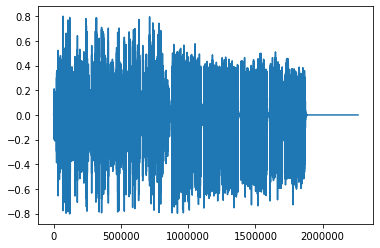

In [221]:
yTest_memohon_maaf, srTest_memohon_maaf = librosa.load('jt_memohon_maaf.flac')
plt.plot(yTest_memohon_maaf)
Audio(data=yTest_memohon_maaf, rate=srTest_memohon_maaf)

In [222]:
y1_memohon_maaf, sr1_memohon_maaf = librosa.load('MemohonMaaf1.flac')

In [223]:
mfcc_memohon_maaf_1 = librosa.feature.mfcc(y1_memohon_maaf, sr1_memohon_maaf)

mfccTest_memohon_maaf = librosa.feature.mfcc(yTest_memohon_maaf,srTest_memohon_maaf)

In [224]:
### try new way
window_size_4 = mfcc_memohon_maaf_1.shape[1]

dists_4 = np.zeros(mfccTest_memohon_maaf.shape[1] - window_size_4)
cost_matrix_4 = []

for i in range(len(dists_4)):
    mfcci = mfccTest_memohon_maaf[:,i:i+window_size_4]
    cost_matrix_4.append(fill_dtw_cost_matrix_fast(mfcc_memohon_maaf_1[1],mfcci[1]))

In [300]:
### try new way
cost_list_4 =[]
for i in range(len(cost_matrix_4)):
    cost_list_4.append(cal_Cost(cost_matrix_4[i]))
    
a4,b4,c4 = min(cost_list_4)

print(f"Average: {a4/b4}")
print(exist(a4,b4))

Average: 1735.8424176025392
The word is not existed in the video


# Testset 5 - No Word - HowAreYou (OneTwoThree) (Failed)


In [226]:
### try the fast way
window_size_5 = mfcc1.shape[1]

dists_5 = np.zeros(mfccTest_3.shape[1] - window_size_5)
cost_matrix_5 = []

for i in range(len(dists_5)):
    mfcci = mfccTest_3[:,i:i+window_size_5]
    cost_matrix_5.append(fill_dtw_cost_matrix_fast(mfcc1[1],mfcci[1]))

In [301]:
### try the fast way
cost_list_5 =[]
for i in range(len(cost_matrix_5)):
    cost_list_5.append(cal_Cost(cost_matrix_5[i]))
    
a5,b5,c5 = min(cost_list_5)

print(f"Average: {a5/b5}")
print(exist(a5,b5))

Average: 1580.6815375101935
The word is existed in the video


# Testset 6 -  Target Video 1 (Target)


In [228]:
yTest_6, srTest_6 = librosa.load('TargetVideo1.flac')
Audio(data=yTest_6, rate=srTest_6)

In [229]:
y1_target, sr1_target = librosa.load('target.flac')


In [230]:
mfccTest_target = librosa.feature.mfcc(yTest_6,srTest_6)
mfcc_target = librosa.feature.mfcc(y1_target,sr1_target)

In [231]:
### try the fast way
window_size_6 = mfcc_target.shape[1]

dists_6 = np.zeros(mfccTest_target.shape[1] - window_size_6)
cost_matrix_6 = []

for i in range(len(dists_6)):
    mfcci = mfccTest_target[:,i:i+window_size_6]
    cost_matrix_6.append(fill_dtw_cost_matrix_fast(mfcc_target[1],mfcci[1]))

In [302]:
### try the fast way
cost_list_6 =[]
for i in range(len(cost_matrix_6)):
    cost_list_6.append(cal_Cost(cost_matrix_6[i]))
    
a6,b6,c6 = min(cost_list_6)

print(f"Average: {a6/b6}")
print(exist(a6,b6))

Average: 1135.9203409977097
The word is existed in the video


# Testset 7 - Target Video 2 (Target) 


In [233]:
yTest_7, srTest_7 = librosa.load('TargetVideo2.flac')
Audio(data=yTest_7, rate=srTest_7)

In [234]:
mfccTest_target2 = librosa.feature.mfcc(yTest_7,srTest_7)

In [235]:
### try the fast way
window_size_7 = mfcc_target.shape[1]

dists_7 = np.zeros(mfccTest_target2.shape[1] - window_size_7)
cost_matrix_7 = []

for i in range(len(dists_7)):
    mfcci = mfccTest_target2[:,i:i+window_size_7]
    cost_matrix_7.append(fill_dtw_cost_matrix_fast(mfcc_target[1],mfcci[1]))

In [303]:
### try the fast way
cost_list_7 =[]
for i in range(len(cost_matrix_7)):
    cost_list_7.append(cal_Cost(cost_matrix_7[i]))
    
a7,b7,c7 = min(cost_list_7)

print(f"Average: {a7/b7}")
print(exist(a7,b7))

Average: 1307.7210578365602
The word is existed in the video


# Testset 8 - Target Video 3 (Target)


In [237]:
yTest_8, srTest_8 = librosa.load('TargetVideo3.flac')
Audio(data=yTest_8, rate=srTest_8)

In [238]:
mfccTest_target3 = librosa.feature.mfcc(yTest_8,srTest_8)

In [239]:
### try the fast way
window_size_8 = mfcc_target.shape[1]

dists_8 = np.zeros(mfccTest_target3.shape[1] - window_size_8)
cost_matrix_8 = []

for i in range(len(dists_8)):
    mfcci = mfccTest_target3[:,i:i+window_size_8]
    cost_matrix_8.append(fill_dtw_cost_matrix_fast(mfcc_target[1],mfcci[1]))

In [304]:
### try the fast way
cost_list_8 =[]
for i in range(len(cost_matrix_8)):
    cost_list_8.append(cal_Cost(cost_matrix_8[i]))
    
a8,b8,c8 = min(cost_list_8)

print(f"Average: {a8/b8}")
print(exist(a8,b8))

Average: 2177.1726870499256
The word is not existed in the video


# Testset 9 - No Word - OneToTen (Memohon Maaf) (Failed)

In [241]:
### try the fast way
window_size_9 = mfcc_memohon_maaf_1.shape[1]

dists_9 = np.zeros(mfccTest.shape[1] - window_size_9)
cost_matrix_9 = []

for i in range(len(dists_9)):
    mfcci = mfccTest[:,i:i+window_size_9]
    cost_matrix_9.append(fill_dtw_cost_matrix_fast(mfcc_memohon_maaf_1[1],mfcci[1]))

In [305]:
### try the fast way
cost_list_9 =[]
for i in range(len(cost_matrix_9)):
    cost_list_9.append(cal_Cost(cost_matrix_9[i]))
    
a9,b9,c9 = min(cost_list_9)

print(f"Average: {a9/b9}")
print(exist(a9,b9))

Average: 2260.2563320826557
The word is not existed in the video


# Testset 10 - No Word - HowAreYou (Memohon Maaf) (Failed)

In [243]:
### try the fast way
window_size_10 = mfcc_memohon_maaf_1.shape[1]

dists_10 = np.zeros(mfccTest_3.shape[1] - window_size_10)
cost_matrix_10 = []

for i in range(len(dists_10)):
    mfcci = mfccTest_3[:,i:i+window_size_10]
    cost_matrix_10.append(fill_dtw_cost_matrix_fast(mfcc_memohon_maaf_1[1],mfcci[1]))

In [306]:
### try the fast way
cost_list_10 =[]
for i in range(len(cost_matrix_10)):
    cost_list_10.append(cal_Cost(cost_matrix_10[i]))
    
a10,b10,c10 = min(cost_list_10)

print(f"Average: {a10/b10}")
print(exist(a10,b10))

Average: 2724.823045136208
The word is not existed in the video


# Testset 11 - Poem -  (Single Mother)


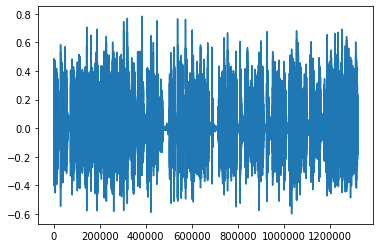

In [245]:
yTest_poem, srTest_poem = librosa.load('poem.flac')
plt.plot(yTest_poem)
Audio(data=yTest_poem, rate=srTest_poem)

In [246]:
y1_poem, sr1_poem = librosa.load('SingleMother.flac')

In [247]:
mfcc1_poem = librosa.feature.mfcc(y1_poem, sr1_poem)

mfccTest_poem = librosa.feature.mfcc(yTest_poem,srTest_poem)

In [248]:
## try the fasy way
window_size_11 = mfcc1_poem.shape[1]

dists_11 = np.zeros(mfccTest_poem.shape[1] - window_size_11)
cost_matrix_11 = []

for i in range(len(dists_11)):
    mfcci = mfccTest_poem[:,i:i+window_size_11]
    cost_matrix_11.append(fill_dtw_cost_matrix_fast(mfcc1_poem[1],mfcci[1]))

In [307]:
### try the fast way
cost_list_11 =[]
for i in range(len(cost_matrix_11)):
    cost_list_11.append(cal_Cost(cost_matrix_11[i]))
    
a11,b11,c11 = min(cost_list_11)

print(f"Average: {a11/b11}")
print(exist(a11,b11))

Average: 1084.976320584615
The word is existed in the video


# Testset 12 - No Word - Poem -  (Meminta Maaf)


In [250]:
### try the fast way
window_size_12 = mfcc_memohon_maaf_1.shape[1]

dists_12 = np.zeros(mfccTest_poem.shape[1] - window_size_12)
cost_matrix_12 = []

for i in range(len(dists_12)):
    mfcci = mfccTest_poem[:,i:i+window_size_12]
    cost_matrix_12.append(fill_dtw_cost_matrix_fast(mfcc_memohon_maaf_1[1],mfcci[1]))

In [308]:
### try the fast way
cost_list_12 =[]
for i in range(len(cost_matrix_12)):
    cost_list_12.append(cal_Cost(cost_matrix_12[i]))
    
a12,b12,c12 = min(cost_list_12)

print(f"Average: {a12/b12}")
print(exist(a12,b12))

Average: 2392.5611716270446
The word is not existed in the video


# Testset 13 - No Word - Poem -  (OneTwoThree)


In [252]:
### try the fast way
window_size_13 = mfcc1.shape[1]

dists_13 = np.zeros(mfccTest_poem.shape[1] - window_size_13)
cost_matrix_13 = []

for i in range(len(dists_13)):
    mfcci = mfccTest_poem[:,i:i+window_size_13]
    cost_matrix_13.append(fill_dtw_cost_matrix_fast(mfcc1[1],mfcci[1]))

In [309]:
### try the fast way
cost_list_13 =[]
for i in range(len(cost_matrix_13)):
    cost_list_13.append(cal_Cost(cost_matrix_13[i]))
    
a13,b13,c13 = min(cost_list_13)

print(f"Average: {a13/b13}")
print(exist(a13,b13))

Average: 1732.2345879383577
The word is not existed in the video


# Testset 14 - No Word - Poem -  (FiveSixSeven)


In [254]:
### try the fast way
window_size_14 = mfcc1_2.shape[1]

dists_14 = np.zeros(mfccTest_poem.shape[1] - window_size_14)
cost_matrix_14 = []

for i in range(len(dists_14)):
    mfcci = mfccTest_poem[:,i:i+window_size_14]
    cost_matrix_14.append(fill_dtw_cost_matrix_fast(mfcc1_2[1],mfcci[1]))

In [310]:
### try the fast way
cost_list_14 =[]
for i in range(len(cost_matrix_14)):
    cost_list_14.append(cal_Cost(cost_matrix_14[i]))
    
a14,b14,c14 = min(cost_list_14)

print(f"Average: {a14/b14}")
print(exist(a14,b14))

Average: 2144.836694833709
The word is not existed in the video


# Testset 15 - No Word - OneToTen -  (Single Mother)


In [256]:
### try the fast way
window_size_15 = mfcc1_poem.shape[1]

dists_15 = np.zeros(mfccTest.shape[1] - window_size_15)
cost_matrix_15 = []

for i in range(len(dists_15)):
    mfcci = mfccTest[:,i:i+window_size_15]
    cost_matrix_15.append(fill_dtw_cost_matrix_fast(mfcc1_poem[1],mfcci[1]))

In [311]:
### try the fast way
cost_list_15 =[]
for i in range(len(cost_matrix_15)):
    cost_list_15.append(cal_Cost(cost_matrix_15[i]))
    
a15,b15,c15 = min(cost_list_15)

print(f"Average: {a15/b15}")
print(exist(a15,b15))

Average: 1733.7790076157141
The word is not existed in the video


# Testset 16 - No Word - How Are You -  (Single Mother)


In [258]:
### try the fast way
window_size_16 = mfcc1_poem.shape[1]

dists_16 = np.zeros(mfccTest_3.shape[1] - window_size_16)
cost_matrix_16 = []

for i in range(len(dists_16)):
    mfcci = mfccTest_3[:,i:i+window_size_16]
    cost_matrix_16.append(fill_dtw_cost_matrix_fast(mfcc1_poem[1],mfcci[1]))

In [312]:
### try the fast way
cost_list_16 =[]
for i in range(len(cost_matrix_16)):
    cost_list_16.append(cal_Cost(cost_matrix_16[i]))
    
a16,b16,c16 = min(cost_list_16)

print(f"Average: {a16/b16}")
print(exist(a16,b16))

Average: 2022.7138042597808
The word is not existed in the video


# Testset 17 - No Word - Target Video 1 -  (Single Mother)


In [260]:
### try the fast way
window_size_17 = mfcc1_poem.shape[1]

dists_17 = np.zeros(mfccTest_target.shape[1] - window_size_17)
cost_matrix_17 = []

for i in range(len(dists_17)):
    mfcci = mfccTest_target[:,i:i+window_size_17]
    cost_matrix_17.append(fill_dtw_cost_matrix_fast(mfcc1_poem[1],mfcci[1]))

In [313]:
### try the fast way
cost_list_17 =[]
for i in range(len(cost_matrix_17)):
    cost_list_17.append(cal_Cost(cost_matrix_17[i]))
    
a17,b17,c17 = min(cost_list_17)

print(f"Average: {a17/b17}")
print(exist(a17,b17))

Average: 1471.6709059516857
The word is existed in the video


# Testset 18 - University Video 1 -  (University)


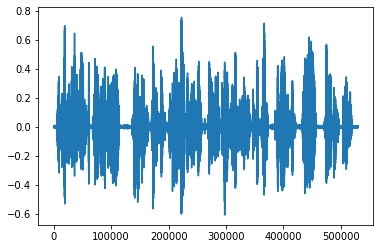

In [262]:
yTest_uni1, srTest_uni1 = librosa.load('UniversityVideo1.flac')
plt.plot(yTest_uni1)
Audio(data=yTest_uni1, rate=srTest_uni1)

In [263]:
y1_uni, sr1_uni = librosa.load('University.flac')

In [264]:
mfcc_uni = librosa.feature.mfcc(y1_uni, sr1_uni)

mfccTest_uni1 = librosa.feature.mfcc(yTest_uni1,srTest_uni1)

In [265]:
### try the fast way
window_size_18 = mfcc_uni.shape[1]

dists_18 = np.zeros(mfccTest_uni1.shape[1] - window_size_18)
cost_matrix_18 = []

for i in range(len(dists_18)):
    mfcci = mfccTest_uni1[:,i:i+window_size_18]
    cost_matrix_18.append(fill_dtw_cost_matrix_fast(mfcc_uni[1],mfcci[1]))

In [314]:
cost_list_18 =[]
for i in range(len(cost_matrix_18)):
    cost_list_18.append(cal_Cost(cost_matrix_18[i]))
    
a18,b18,c18 = min(cost_list_18)

print(f"Average: {a18/b18}")
print(exist(a18,b18))

Average: 1143.8339880346282
The word is existed in the video


# Testset 19 - University Video 2 -  (University)


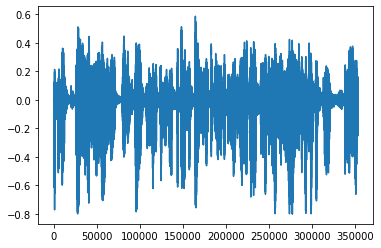

In [324]:
yTest_uniVideo, srTest_uniVideo = librosa.load('UniversityVideo2.flac')
plt.plot(yTest_uniVideo)
Audio(data=yTest_uniVideo, rate=srTest_uniVideo)

In [326]:
mfccTest_uniVideo = librosa.feature.mfcc(yTest_uniVideo,srTest_uniVideo)

In [331]:
### try the fast way
window_size_uniVideo = mfcc_uni.shape[1]

dists_uniVideo = np.zeros(mfccTest_uniVideo.shape[1] - window_size_uniVideo)
cost_matrix_uniVideo = []

for i in range(len(dists_uniVideo)):
    mfcci = mfccTest_uniVideo[:,i:i+window_size_uniVideo]
    cost_matrix_uniVideo.append(fill_dtw_cost_matrix_fast(mfcc_uni[1],mfcci[1]))

In [332]:
### try the fast way
cost_list_uniVideo =[]
for i in range(len(cost_matrix_uniVideo)):
    cost_list_uniVideo.append(cal_Cost(cost_matrix_uniVideo[i]))
    
cost_uniVideo,num_element_uniVideo,elemenet_uniVideo = min(cost_list_uniVideo)

print(f"Average: {cost_uniVideo/num_element_uniVideo}")
print(exist(cost_uniVideo,num_element_uniVideo))

Average: 1036.0202657846305
The word is existed in the video


# Testset 20 - University Video 3 -  (University)


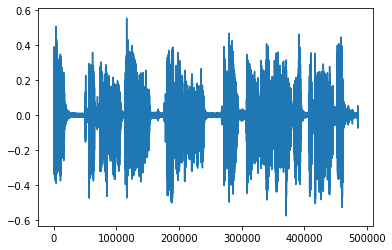

In [271]:
yTest_uni3, srTest_uni3 = librosa.load('UniversityVideo3.flac')
plt.plot(yTest_uni3)
Audio(data=yTest_uni3, rate=srTest_uni3)

In [272]:
mfccTest_uni3 = librosa.feature.mfcc(yTest_uni3,srTest_uni3)

In [273]:
### try the fast way
window_size_20 = mfcc_uni.shape[1]

dists_20 = np.zeros(mfccTest_uni3.shape[1] - window_size_20)
cost_matrix_20 = []

for i in range(len(dists_20)):
    mfcci = mfccTest_uni3[:,i:i+window_size_20]
    cost_matrix_20.append(fill_dtw_cost_matrix_fast(mfcc_uni[1],mfcci[1]))

In [316]:
### try the fast way
cost_list_20 =[]
for i in range(len(cost_matrix_20)):
    cost_list_20.append(cal_Cost(cost_matrix_20[i]))
    
a20,b20,c20 = min(cost_list_20)

print(f"Average: {a20/b20}")
print(exist(a20,b20))

Average: 1331.4912614900559
The word is existed in the video


# Testset 21 - Single Mother Video 2 -  (Single Mother)


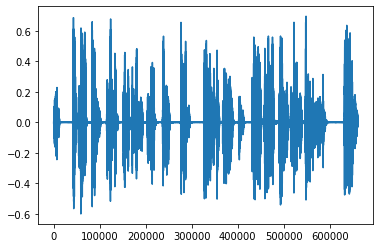

In [275]:
yTest_sm2, srTest_sm2 = librosa.load('SingleMotherVideo2.flac')
plt.plot(yTest_sm2)
Audio(data=yTest_sm2, rate=srTest_sm2)

In [276]:
mfccTest_sm2 = librosa.feature.mfcc(yTest_sm2,srTest_sm2)

In [277]:
### try the fast way
window_size_21 = mfcc1_poem.shape[1]

dists_21 = np.zeros(mfccTest_sm2.shape[1] - window_size_21)
cost_matrix_21 = []

for i in range(len(dists_21)):
    mfcci = mfccTest_sm2[:,i:i+window_size_21]
    cost_matrix_21.append(fill_dtw_cost_matrix_fast(mfcc1_poem[1],mfcci[1]))

In [317]:
### try the fast way
cost_list_21 =[]
for i in range(len(cost_matrix_21)):
    cost_list_21.append(cal_Cost(cost_matrix_21[i]))
    
a21,b21,c21 = min(cost_list_21)

print(f"Average: {a21/b21}")
print(exist(a21,b21))

Average: 2037.4155871968874
The word is not existed in the video


# Testset 22 - Single Mother Video 3 -  (Single Mother)


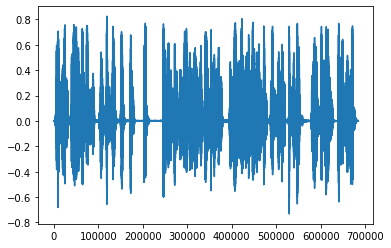

In [279]:
yTest_sm3, srTest_sm3 = librosa.load('SingleMotherVideo3.flac')
plt.plot(yTest_sm3)
Audio(data=yTest_sm3, rate=srTest_sm3)

In [280]:
mfccTest_sm3 = librosa.feature.mfcc(yTest_sm3,srTest_sm3)

In [281]:
### try the fast way
window_size_22 = mfcc1_poem.shape[1]

dists_22 = np.zeros(mfccTest_sm3.shape[1] - window_size_22)
cost_matrix_22 = []

for i in range(len(dists_22)):
    mfcci = mfccTest_sm3[:,i:i+window_size_22]
    cost_matrix_22.append(fill_dtw_cost_matrix_fast(mfcc1_poem[1],mfcci[1]))

In [318]:
### try the fast way
cost_list_22 =[]
for i in range(len(cost_matrix_22)):
    cost_list_22.append(cal_Cost(cost_matrix_22[i]))
    
a22,b22,c22 = min(cost_list_22)

print(f"Average: {a22/b22}")
print(exist(a22,b22))

Average: 1688.714046941084
The word is existed in the video


# Testset 23 - Single Mother Video 4 -  (Single Mother)


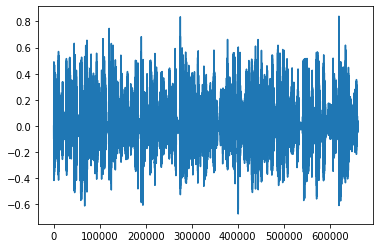

In [283]:
yTest_sm4, srTest_sm4 = librosa.load('SingleMotherVideo4.flac')
plt.plot(yTest_sm4)
Audio(data=yTest_sm4, rate=srTest_sm4)

In [284]:
mfccTest_sm4 = librosa.feature.mfcc(yTest_sm4,srTest_sm4)

In [285]:
### try the fast way
window_size_23 = mfcc1_poem.shape[1]

dists_23 = np.zeros(mfccTest_sm4.shape[1] - window_size_23)
cost_matrix_23 = []

for i in range(len(dists_23)):
    mfcci = mfccTest_sm4[:,i:i+window_size_23]
    cost_matrix_23.append(fill_dtw_cost_matrix_fast(mfcc1_poem[1],mfcci[1]))

In [319]:
### try the fast way
cost_list_23 =[]
for i in range(len(cost_matrix_23)):
    cost_list_23.append(cal_Cost(cost_matrix_23[i]))
    
a23,b23,c23 = min(cost_list_23)

print(f"Average: {a23/b23}")
print(exist(a23,b23))

Average: 1575.0549047861668
The word is existed in the video


# Testset 24 - No Word - University Video 2 -  (Target)


In [333]:
### try the fast way
window_size_uniVideo_2 = mfcc_target.shape[1]

dists_uniVideo_2 = np.zeros(mfccTest_uniVideo.shape[1] - window_size_uniVideo_2)
cost_matrix_uniVideo_2 = []

for i in range(len(dists_uniVideo_2)):
    mfcci = mfccTest_uniVideo[:,i:i+window_size_uniVideo_2]
    cost_matrix_uniVideo_2.append(fill_dtw_cost_matrix_fast(mfcc_target[1],mfcci[1]))

In [334]:
### try the fast way
cost_list_uniVideo_2 =[]
for i in range(len(cost_matrix_uniVideo_2)):
    cost_list_uniVideo_2.append(cal_Cost(cost_matrix_uniVideo_2[i]))
    
cost_uniVideo_2,num_element_uniVideo_2,elemenet_uniVideo_2 = min(cost_list_uniVideo_2)

print(f"Average: {cost_uniVideo_2/num_element_uniVideo_2}")
print(exist(cost_uniVideo_2,num_element_uniVideo_2))

Average: 1924.9059420913013
The word is not existed in the video


# Testset 25 - No Word - University Video 3 -  (Single Mother)


In [289]:
### try the fast way
window_size_25 = mfcc1_poem.shape[1]

dists_25 = np.zeros(mfccTest_uni3.shape[1] - window_size_25)
cost_matrix_25 = []

for i in range(len(dists_25)):
    mfcci = mfccTest_uni3[:,i:i+window_size_25]
    cost_matrix_25.append(fill_dtw_cost_matrix_fast(mfcc1_poem[1],mfcci[1]))

In [321]:
### try the fast way
cost_list_25 =[]
for i in range(len(cost_matrix_25)):
    cost_list_25.append(cal_Cost(cost_matrix_25[i]))
    
a25,b25,c25 = min(cost_list_25)

print(f"Average: {a25/b25}")
print(exist(a25,b25))

Average: 1741.6793949335395
The word is not existed in the video


# Testset 26 - No Word - Single Mother Video 3 -  (University)


In [291]:
### try the fast way
window_size_26 = mfcc_uni.shape[1]

dists_26 = np.zeros(mfccTest_sm3.shape[1] - window_size_26)
cost_matrix_26 = []

for i in range(len(dists_26)):
    mfcci = mfccTest_sm3[:,i:i+window_size_26]
    cost_matrix_26.append(fill_dtw_cost_matrix_fast(mfcc_uni[1],mfcci[1]))

In [322]:
### try the fast way
cost_list_26 =[]
for i in range(len(cost_matrix_26)):
    cost_list_26.append(cal_Cost(cost_matrix_26[i]))
    
a26,b26,c26= min(cost_list_26)

print(f"Average: {a26/b26}")
print(exist(a26,b26))

Average: 1282.8763442117024
The word is existed in the video


# Testset 27 - No Word - Single Mother Video 4 -  (University)


In [293]:
### try the fast way
window_size_27 = mfcc_uni.shape[1]

dists_27 = np.zeros(mfccTest_sm4.shape[1] - window_size_27)
cost_matrix_27 = []

for i in range(len(dists_27)):
    mfcci = mfccTest_sm4[:,i:i+window_size_27]
    cost_matrix_27.append(fill_dtw_cost_matrix_fast(mfcc_uni[1],mfcci[1]))

In [323]:
### try the fast way
cost_list_27 =[]
for i in range(len(cost_matrix_27)):
    cost_list_27.append(cal_Cost(cost_matrix_27[i]))
    
a27,b27,c27 = min(cost_list_27)

print(f"Average: {a27/b27}")
print(exist(a27,b27))

Average: 1356.2039754611103
The word is existed in the video
